# Taller 2 - Ciencia de Datos Aplicada
## Integrantes: Juan Lucas Ibarra Sierra - 201813900
## Objetivo:
Evaluar las capacidades del estudiante para construir modelos de Machine Learning
supervisado contemplando las etapas de la metodología ASUM-DM, como son el
entendimiento y la preparación de datos, entrenamiento y evaluación de modelos, y
análisis de resultados.


# 1. Descargar e importar librerias

In [85]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
!pip install plotly
!pip install cufflinks

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [86]:
import pandas as pd
import numpy as np
import cufflinks as cf
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from pandas_profiling import ProfileReport

from io import StringIO

# Make Plotly work in your Jupyter Notebook
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import Ridge
# Use Plotly locally
cf.go_offline()

# 2. Limpieza y carga de datos

In [87]:
df = pd.read_csv('Data_Taller_2.csv',sep=';')

In [88]:
# Tenemos 731 datos y 12 columnas
df.shape

(731, 12)

In [89]:
df.head(10)

,instant,Date,Season,Holiday,Weather,Temp,Feel_Temp,Hum,Wind,Casual,Registered,cnt
0,1,1/01/2020,Springer,No,Mist + Cloudy,"8,175849","9,090375","0,805833","10,749882",331,654,985
1,2,2/01/2020,Springer,No,Mist + Cloudy,"9,083466","8,625733","0,696087","-16,652113",131,670,801
2,3,3/01/2020,Springer,No,Few clouds,"1,229108","0,902035","0,437273","16,636703",120,1229,1349
3,4,4/01/2020,Springer,No,Few clouds,"1,4","1,969734","0,590435","10,739832",108,1454,1562
4,5,5/01/2020,Springer,No,Partly cloudy,"2,666979","2,77569","0,436957","12,5223",82,1518,1600
5,6,6/01/2020,Springer,No,Clear,"1,604356","2,960823","0,518261","6,0008684",88,1518,1606
6,7,7/01/2020,Springer,No,Mist,"1,236534","1,815433","0,498696","11,304642",148,1362,1510
7,8,8/01/2020,Springer,No,Mist + Broken clouds,"-0,245","-0,374062","0,535833","17,875868",68,891,959
8,9,9/01/2020,Springer,No,Partly cloudy,"-1,498349","-2,539775","0,434167","24,25065",54,768,822
9,10,10/01/2020,Springer,No,Partly cloudy,"-0,910849","-0,908264","0,482917","14,958889",41,1280,1321


In [90]:
df.dtypes

instant        int64
Date          object
Season        object
Holiday       object
Weather       object
Temp          object
Feel_Temp     object
Hum           object
Wind          object
Casual         int64
Registered     int64
cnt            int64
dtype: object

In [91]:
# Valores unicos de Season
df['Season'].unique()

array(['Springer', 'Summer', 'Fall', 'Winter'], dtype=object)

In [92]:
# Valores unicos de Season
df['Weather'].unique()

array(['Mist + Cloudy', 'Few clouds', ' Partly    cloudy', 'Clear',
       'Mist', 'Mist + Broken clouds', ' Partly cloudy',
       'Mist + Few clouds', 'Rain + Thunderstorm',
       'Light Rain + Scattered clouds', 'Snow'], dtype=object)

In [93]:
# Corregimos los valores incorrectos para la categoria Partly Cloudy
df['Weather'] = df['Weather'].apply(lambda x : 'Partly cloudy' if(x == ' Partly    cloudy' or x == ' Partly cloudy') else x)
df['Weather'].unique()

array(['Mist + Cloudy', 'Few clouds', 'Partly cloudy', 'Clear', 'Mist',
       'Mist + Broken clouds', 'Mist + Few clouds', 'Rain + Thunderstorm',
       'Light Rain + Scattered clouds', 'Snow'], dtype=object)

In [94]:
# Convertir las variables a numericas (tipo float)

# Reemplaza las comas por puntos
df['Temp'] = df['Temp'].apply(lambda x : x.replace(',','.') if(isinstance(x, str)) else x)
# Convierte la columna a numerico
df["Temp"] = pd.to_numeric(df["Temp"], downcast="float")

df['Feel_Temp'] = df['Feel_Temp'].apply(lambda x : x.replace(',','.') if(isinstance(x, str)) else x)
df["Feel_Temp"] = pd.to_numeric(df["Feel_Temp"], downcast="float")

df['Hum'] = df['Hum'].apply(lambda x : x.replace(',','.') if(isinstance(x, str)) else x)
df["Hum"] = pd.to_numeric(df["Hum"], downcast="float")

df['Wind'] = df['Wind'].apply(lambda x : x.replace(',','.') if(isinstance(x, str)) else x)
df["Wind"] = pd.to_numeric(df["Wind"], downcast="float")

In [95]:
df['Date'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", errors='coerce')

In [96]:
df.dtypes

instant                int64
Date          datetime64[ns]
Season                object
Holiday               object
Weather               object
Temp                 float32
Feel_Temp            float32
Hum                  float32
Wind                 float32
Casual                 int64
Registered             int64
cnt                    int64
dtype: object

In [97]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [98]:
# Rellenamos los vacios con el anterior valor en la misma columna, los datos estan ordenados por fecha y se puede asumir que el siguiente dato se encuentra en la misma estacion
df['Temp'] = df['Temp'].fillna(method="ffill")

In [99]:
# Se hace el fix recomendado por el experto meteorologo
def fix_weather(x):
  if 'Mist' in x:
    return 'Mist'
  elif 'Rain ' in x:
    return 'Rain'
  else:
    return 'Other'

df['Weather'] = df['Weather'].apply(fix_weather)
df['Weather']

0       Mist
1       Mist
2      Other
3      Other
4      Other
       ...  
726     Mist
727     Mist
728     Mist
729    Other
730     Mist
Name: Weather, Length: 731, dtype: object

In [100]:
df

,instant,Date,Season,Holiday,Weather,Temp,Feel_Temp,Hum,Wind,Casual,Registered,cnt
0,1,2020-01-01,Springer,No,Mist,8.175849,9.090375,0.805833,10.749882,331,654,985
1,2,2020-01-02,Springer,No,Mist,9.083466,8.625733,0.696087,-16.652113,131,670,801
2,3,2020-01-03,Springer,No,Other,1.229108,0.902035,0.437273,16.636703,120,1229,1349
3,4,2020-01-04,Springer,No,Other,1.400000,1.969734,0.590435,10.739832,108,1454,1562
4,5,2020-01-05,Springer,No,Other,2.666979,2.775690,0.436957,12.522300,82,1518,1600
...,...,...,...,...,...,...,...,...,...,...,...,...
726,727,2021-12-27,Springer,No,Mist,3.945849,2.652174,0.652917,23.458912,247,1867,2114
727,728,2021-12-28,Springer,No,Mist,3.906651,3.987162,0.590000,10.416557,644,2451,3095
728,729,2021-12-29,Springer,No,Mist,3.906651,3.392800,0.752917,8.333661,159,1182,1341
729,730,2021-12-30,Springer,No,Other,4.024151,2.889900,0.483333,23.500519,364,1432,1796


In [101]:
# Fechas unicas, no tenemos repetidos
df['Date'].unique().shape

(731,)

In [102]:
# Separamos la fecha en dia, mes, anio
df['Year'] = df['Date'].dt.year
df['Month'] = df['Date'].dt.month
df['Day'] = df['Date'].dt.day

df

,instant,Date,Season,Holiday,Weather,Temp,Feel_Temp,Hum,Wind,Casual,Registered,cnt,Year,Month,Day
0,1,2020-01-01,Springer,No,Mist,8.175849,9.090375,0.805833,10.749882,331,654,985,2020.0,1.0,1.0
1,2,2020-01-02,Springer,No,Mist,9.083466,8.625733,0.696087,-16.652113,131,670,801,2020.0,1.0,2.0
2,3,2020-01-03,Springer,No,Other,1.229108,0.902035,0.437273,16.636703,120,1229,1349,2020.0,1.0,3.0
3,4,2020-01-04,Springer,No,Other,1.400000,1.969734,0.590435,10.739832,108,1454,1562,2020.0,1.0,4.0
4,5,2020-01-05,Springer,No,Other,2.666979,2.775690,0.436957,12.522300,82,1518,1600,2020.0,1.0,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,727,2021-12-27,Springer,No,Mist,3.945849,2.652174,0.652917,23.458912,247,1867,2114,2021.0,12.0,27.0
727,728,2021-12-28,Springer,No,Mist,3.906651,3.987162,0.590000,10.416557,644,2451,3095,2021.0,12.0,28.0
728,729,2021-12-29,Springer,No,Mist,3.906651,3.392800,0.752917,8.333661,159,1182,1341,2021.0,12.0,29.0
729,730,2021-12-30,Springer,No,Other,4.024151,2.889900,0.483333,23.500519,364,1432,1796,2021.0,12.0,30.0


## 3. Analisis de datos

In [103]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**instant**: Variable numerica discreta que indica el id de la toma del dato. Su minimo es 1 y su maximo es 731. Se va a eliminar debido a que no brinda informacion al modelo.

**Date**: Variable categorica nominal que indica la fecha en la que se tomo el dato. El minimo es 2020-01-01 y el maximo es 2021-12-31. Se elimina la columna ya que los datos se usaron para generar columnas separadas para anio, mes y dia.

**Season**: Variable categorica nominal. Tenemos 4 categorias que estan bastante balanceadas, no tenemos vacios.

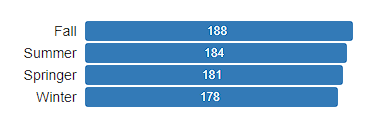

**Holiday**: Variable categorica nominal. Tenemos 2 categoiras que se encuentran balanceadas, por lo cual no vamos a tomar esa columna para realizar la constuccion del modelo. No tiene vacios.

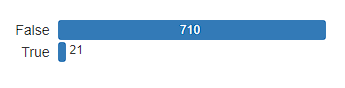

**Weather**: Variable categorica nominal. Se convirtio a 3 categorias por recomendacion del experto. Los vacios se trataron tomando el anterior valor asumiendo que esta en una epoca de temperatura cercana en el anio.

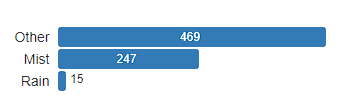

**Temp**: Variable numerica continua. Su valor minimo es de -5.220870972 grados y su valor maximo es de 32.498 grados. Su promedio es de 15.27 grados y su varianza es de 8.54 grados.

**Feel_Temp**: Variable numerica continua. Su valor minimo es de -4.288 grados y su valor maximo es de 31.522 grados. Su promedio es de 14.29 grados y su varianza es de 7.65 grados. Por su alta correlacion y similutud con Temp se decidio no tomar la columna.

**Hum**: Variable numerica continua. Su valor minimo es de 0 y su valor maximo es de 10.86. Su promedio es de 0.68 y su varianza es de 0.75

**Wind**: Variable numerica continua. Su valor minimo es de -16.65 y su valor maximo es de 34. Su promedio es de 12.66 y su varianza es de 5.4

**Casual**: Variable numerica discreta. Su valor minimo es de 2 y su valor maximo es de 3410. Su promedio es de 848 y su varianza es de 686. Se elimina pues no aporta valor al modelo.

**Registered**: Variable numerica discreta. Su valor minimo es de 20 y su valor maximo es de 6946. Su promedio es de 3656 y su varianza es de 1560. Se elimina pues no aporta valor al modelo.

**cnt**: Variable numerica discreta. Es nuestra variable objetivo. Su valor minimo es de 22 y su valor maximo es de 8714. Su promedio es de 4504 y su varianza es de 1937.

**Year, Month, Day**: Variable numerica discreta. Tenemos informacion de todos los dias desde enero  de 2020 y hasta diciembre de 2021. 

**Correlaciones**:
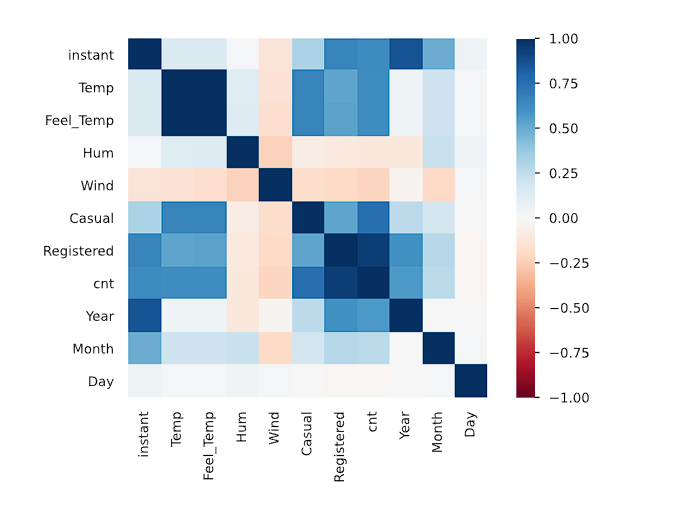

Vemos correlaciones positivas muy altas entre:

*   Temp y Feel_Temp
*   Year e Instant
*   cnt y Registered

Vemos correlaciones neutras:

*   Wind y Year
*   Day y la mayoria de columnas

Finalmente, no vemos correlaciones negativas muy altas entre las columnas





In [104]:
df.describe()

,instant,Temp,Feel_Temp,Hum,Wind,Casual,Registered,cnt,Year,Month,Day
count,731.000000,731.000000,731.000000,731.000000,731.000000,731.000000,731.000000,731.000000,730.000000,730.000000,730.000000
mean,366.000000,15.281210,14.294639,0.682614,12.668792,848.176471,3656.172367,4504.348837,2020.500000,6.526027,15.720548
std,211.165812,8.601731,7.659175,0.750679,5.417463,686.622488,1560.256377,1937.211452,0.500343,3.450215,8.802278
min,1.000000,-5.220871,-4.283729,0.000000,-16.652113,2.000000,20.000000,22.000000,2020.000000,1.000000,1.000000
25%,183.500000,7.842925,7.878597,0.522291,9.000746,315.500000,2497.000000,3152.000000,2020.000000,4.000000,8.000000
50%,366.000000,15.421651,14.876451,0.629167,12.124789,713.000000,3662.000000,4548.000000,2020.500000,7.000000,16.000000
75%,548.500000,22.804575,20.604294,0.732709,15.624802,1096.000000,4776.500000,5956.000000,2021.000000,10.000000,23.000000
max,731.000000,32.498348,31.522112,10.867083,34.000023,3410.000000,6946.000000,8714.000000,2021.000000,12.000000,31.000000


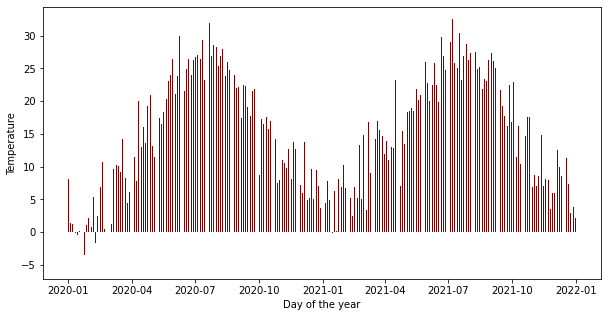

In [105]:
fig = plt.figure(figsize = (10, 5))
 
# creating the bar plot
plt.bar(df['Date'], df['Temp'], color ='maroon',
        width = 0.4)
 
plt.xlabel("Day of the year")
plt.ylabel("Temperature")
plt.show()

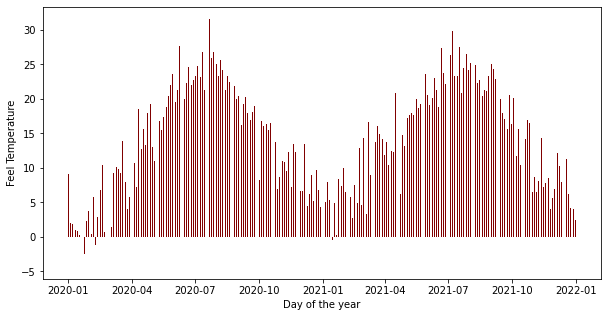

In [106]:
fig = plt.figure(figsize = (10, 5))
 
# creating the bar plot
plt.bar(df['Date'], df['Feel_Temp'], color ='maroon',
        width = 0.4)
 
plt.xlabel("Day of the year")
plt.ylabel("Feel Temperature")
plt.show()

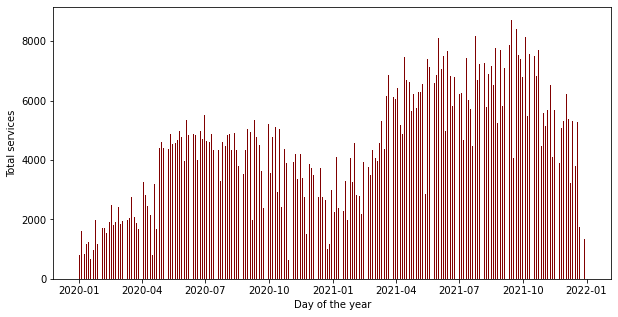

In [107]:
fig = plt.figure(figsize = (10, 5))
 
# creating the bar plot
plt.bar(df['Date'], df['cnt'], color ='maroon',
        width = 0.4)
 
plt.xlabel("Day of the year")
plt.ylabel("Total services")
plt.show()

In [108]:
# Una vez descrito el dataset y los ajustes procedemos a eliminar las columnas que no se utilizaran
df_final = df.drop(columns=['instant', 'Date','Holiday','Feel_Temp','Casual','Registered'])
df_final

,Season,Weather,Temp,Hum,Wind,cnt,Year,Month,Day
0,Springer,Mist,8.175849,0.805833,10.749882,985,2020.0,1.0,1.0
1,Springer,Mist,9.083466,0.696087,-16.652113,801,2020.0,1.0,2.0
2,Springer,Other,1.229108,0.437273,16.636703,1349,2020.0,1.0,3.0
3,Springer,Other,1.400000,0.590435,10.739832,1562,2020.0,1.0,4.0
4,Springer,Other,2.666979,0.436957,12.522300,1600,2020.0,1.0,5.0
...,...,...,...,...,...,...,...,...,...
726,Springer,Mist,3.945849,0.652917,23.458912,2114,2021.0,12.0,27.0
727,Springer,Mist,3.906651,0.590000,10.416557,3095,2021.0,12.0,28.0
728,Springer,Mist,3.906651,0.752917,8.333661,1341,2021.0,12.0,29.0
729,Springer,Other,4.024151,0.483333,23.500519,1796,2021.0,12.0,30.0


In [109]:
df_final.dtypes
is_NaN = df_final.isnull()
row_has_NaN = is_NaN.any(axis=1)
rows_with_NaN = df_final[row_has_NaN]
rows_with_NaN

,Season,Weather,Temp,Hum,Wind,cnt,Year,Month,Day
424,Springer,Mist,8.184356,0.804783,12.000839,1834,NaN,NaN,NaN


In [110]:
# Usamos One Hot Encoder para las variables categoricas
# One Hot Encoder
ohe = OneHotEncoder()

# Neighborhood group
transformed = ohe.fit_transform(df_final[['Season']])

df_final[ohe.categories_[0]] = transformed.toarray()
df_final.drop('Season', axis=1, inplace=True) 
df_final.head()

,Weather,Temp,Hum,Wind,cnt,Year,Month,Day,Fall,Springer,Summer,Winter
0,Mist,8.175849,0.805833,10.749882,985,2020.0,1.0,1.0,0.0,1.0,0.0,0.0
1,Mist,9.083466,0.696087,-16.652113,801,2020.0,1.0,2.0,0.0,1.0,0.0,0.0
2,Other,1.229108,0.437273,16.636703,1349,2020.0,1.0,3.0,0.0,1.0,0.0,0.0
3,Other,1.400000,0.590435,10.739832,1562,2020.0,1.0,4.0,0.0,1.0,0.0,0.0
4,Other,2.666979,0.436957,12.522300,1600,2020.0,1.0,5.0,0.0,1.0,0.0,0.0


In [111]:
# Neighborhood group
transformed = ohe.fit_transform(df_final[['Weather']])

df_final[ohe.categories_[0]] = transformed.toarray()
df_final.drop('Weather', axis=1, inplace=True) 
df_final.head()

,Temp,Hum,Wind,cnt,Year,Month,Day,Fall,Springer,Summer,Winter,Mist,Other,Rain
0,8.175849,0.805833,10.749882,985,2020.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1,9.083466,0.696087,-16.652113,801,2020.0,1.0,2.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
2,1.229108,0.437273,16.636703,1349,2020.0,1.0,3.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
3,1.400000,0.590435,10.739832,1562,2020.0,1.0,4.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
4,2.666979,0.436957,12.522300,1600,2020.0,1.0,5.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0


In [112]:
# Eliminamos el unico dato sin fecha
df_final = df_final.dropna(subset=['Year'])
df_final

,Temp,Hum,Wind,cnt,Year,Month,Day,Fall,Springer,Summer,Winter,Mist,Other,Rain
0,8.175849,0.805833,10.749882,985,2020.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1,9.083466,0.696087,-16.652113,801,2020.0,1.0,2.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
2,1.229108,0.437273,16.636703,1349,2020.0,1.0,3.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
3,1.400000,0.590435,10.739832,1562,2020.0,1.0,4.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
4,2.666979,0.436957,12.522300,1600,2020.0,1.0,5.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,3.945849,0.652917,23.458912,2114,2021.0,12.0,27.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
727,3.906651,0.590000,10.416557,3095,2021.0,12.0,28.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
728,3.906651,0.752917,8.333661,1341,2021.0,12.0,29.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
729,4.024151,0.483333,23.500519,1796,2021.0,12.0,30.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0


In [113]:
# Dividimos el dataset en test y training
X = df_final.drop(['cnt'], axis=1)
Y = df_final['cnt']

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state = 1)
print(X_train.shape)
print(X_test.shape)
print(Y_train.shape)
print(Y_test.shape)

(584, 13)
(146, 13)
(584,)
(146,)


In [114]:
# Normalizamos los datos para entrenar el modelo
scaler = MinMaxScaler()

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

X_train_scaled

array([[0.41114712, 0.        , 0.67515163, ..., 0.        , 0.        ,
        1.        ],
       [0.59918711, 0.04925256, 0.63433163, ..., 0.        , 1.        ,
        0.        ],
       [0.74767505, 0.0749424 , 0.70058408, ..., 1.        , 0.        ,
        0.        ],
       ...,
       [0.33155697, 0.04660246, 0.50987297, ..., 0.        , 1.        ,
        0.        ],
       [0.76532659, 0.05673427, 0.66355247, ..., 0.        , 1.        ,
        0.        ],
       [0.26483104, 0.06923765, 0.38881813, ..., 0.        , 1.        ,
        0.        ]])

## 4. Construccion del modelo
### 4.1 Modelo lineal sin regularizacion

In [115]:
linear_regr = LinearRegression()
linear_regr.fit(X_train_scaled, Y_train)

LinearRegression()

In [116]:
linear_regr.coef_

array([ 3891.46686093,  -478.97559764, -1854.62604422,  2060.93443505,
         -99.99767967,  -285.48972203,    12.29208335,  -899.72841967,
         320.6106265 ,   566.82570983,   391.93458047,   923.24793311,
       -1315.18251358])

In [117]:
preds_train = linear_regr.predict(X_train_scaled)
preds_test = linear_regr.predict(X_test_scaled)

In [118]:
mean_absolute_error(Y_train, preds_train), mean_absolute_error(Y_test, preds_test)

(648.2319593720395, 570.1974368718211)

In [119]:
np.sqrt(mean_squared_error(Y_train, preds_train)), np.sqrt(mean_squared_error(Y_test, preds_test))

(885.1296257805403, 759.3278158609345)

In [120]:
(Y_test - preds_test).describe(percentiles = [.25, .5, .75, .95, .99])

count     146.000000
mean       54.955100
std       759.943581
min     -3043.198523
25%      -318.534738
50%       123.527319
75%       525.165901
95%      1156.404110
99%      1578.763244
max      1763.319020
Name: cnt, dtype: float64

## 4.2 Modelo polinomial sin regularizacion

In [121]:
poly = PolynomialFeatures(degree=2, include_bias=False)
X_poly = poly.fit_transform(X_train_scaled)
X_test_poly = poly.fit_transform(X_test_scaled)

poly_regr = LinearRegression()
poly_regr.fit(X_poly, Y_train)

LinearRegression()

In [122]:
print(poly_regr.coef_.shape)
poly_regr.coef_

(104,)


array([ 4.47199426e+14,  3.16889375e+04,  1.06747344e+04,  5.10312500e+02,
        1.52680469e+03,  1.13727344e+03,  1.64109375e+03, -4.53742188e+02,
       -1.24832031e+03,  5.92343750e+01,  1.34457812e+03,  1.10031250e+03,
       -2.44154688e+03, -7.45902344e+03, -5.97456953e+04,  3.67593750e+02,
        1.58117188e+03,  2.33743750e+03,  1.90039844e+03, -1.91656897e+14,
       -1.91656897e+14, -1.91656897e+14, -1.91656897e+14, -2.55542529e+14,
       -2.55542529e+14, -2.55542529e+14,  2.60490312e+04, -8.97262812e+04,
       -7.77656250e+03,  2.61947656e+04, -7.93618750e+03,  1.37025156e+04,
        1.11099375e+04,  2.82475234e+04, -2.13711182e+04, -3.95950000e+03,
        1.49948164e+04,  2.06537109e+04, -8.29745312e+03, -8.14648438e+02,
       -2.40019531e+03, -1.41774609e+03,  3.52418750e+03,  1.33746094e+03,
        2.70922461e+03,  3.10623047e+03,  1.36176367e+03,  1.58425000e+03,
        7.72951172e+03,  5.09601562e+02,  2.05289062e+02,  9.21015625e+01,
       -6.47343750e+01,  

In [123]:
preds_train = poly_regr.predict(X_poly)
preds_test = poly_regr.predict(X_test_poly)

In [124]:
mean_absolute_error(Y_train, preds_train), mean_absolute_error(Y_test, preds_test)

(471.7635789614647, 589.3632244212077)

In [125]:
np.sqrt(mean_squared_error(Y_train, preds_train)), np.sqrt(mean_squared_error(Y_test, preds_test))

(644.8359229935231, 848.9665132030412)

In [126]:
(Y_test - preds_test).describe(percentiles = [.25, .5, .75, .95, .99])

count     146.000000
mean       26.878846
std       851.461881
min     -4269.354136
25%      -363.416636
50%        -5.197886
75%       526.975017
95%      1100.626333
99%      2056.291958
max      4196.395864
Name: cnt, dtype: float64

### 4.3 Modelo de grado 2 con regularizacion

In [127]:
models = []
def linear_reg(alpha_level):
  print('Modelo lineal con alpha: ', alpha_level)
  ridge_reg = Ridge(alpha=alpha_level, solver='cholesky')
  ridge_reg.fit(X_poly, Y_train)

  preds_train = ridge_reg.predict(X_poly)
  preds_test = ridge_reg.predict(X_test_poly)

  print((Y_test - preds_test).describe(percentiles = [.25, .5, .75, .95, .99]))
  
  models.append(ridge_reg)
  return [alpha_level,ridge_reg.intercept_, np.sqrt(mean_squared_error(Y_train, preds_train)), np.sqrt(mean_squared_error(Y_test, preds_test))]

data = []
for i in [0.01, 0.1, 1, 10]:
  data.append(linear_reg(i))

results = pd.DataFrame(data,columns=['Alpha','Intercepto','RMSE train','RMSE test'])
results

Modelo lineal con alpha:  0.01
count     146.000000
mean       25.477962
std       774.429905
min     -3281.036692
25%      -326.646079
50%       -13.649304
75%       486.016013
95%      1036.337850
99%      1950.694238
max      3251.642347
Name: cnt, dtype: float64
Modelo lineal con alpha:  0.1
count     146.000000
mean       45.252847
std       700.967596
min     -3036.021827
25%      -281.915795
50%        83.660495
75%       460.048941
95%      1102.396787
99%      1490.409484
max      1867.802131
Name: cnt, dtype: float64
Modelo lineal con alpha:  1
count     146.000000
mean       41.167308
std       683.643602
min     -3015.220493
25%      -265.781396
50%       140.720923
75%       443.711128
95%       992.028687
99%      1514.474783
max      1578.275596
Name: cnt, dtype: float64
Modelo lineal con alpha:  10
count     146.000000
mean       44.731752
std       740.891459
min     -2938.347956
25%      -243.313292
50%       119.821621
75%       450.902320
95%      1094.669519
99%   

,Alpha,Intercepto,RMSE train,RMSE test
0,0.01,-1221.840474,660.904058,772.193618
1,0.10,1264.532130,692.785139,700.027101
2,1.00,2239.074735,743.757044,682.540964
3,10.00,2434.827025,839.397952,739.703560


### Conclusiones
El mejor modelo que pudimos obtener fue un modelo polinomial de grado 2 con regularizacion de 1. El modelo se comporta bastante bien teniendo un error de 743 en entrenamiento y de 682 en test, teniendo un comportamiento aun mejor. El error se puede considerar aceptable pues se encuentra por debajo del 20% de los cuartiles de los datos.

## 5. Interpretacion


In [128]:
final_model = models[2]
coef = final_model.coef_

counter_i = 0
counter_j = 8
coefs_sum = []

for i in range(0, int(coef.shape[0]/8)):
  coefs_sum.append(np.sum(coef[counter_i:counter_j]))
  counter_i += 8
  counter_j += 8

d = {'column': X_train.columns, 'coef': coefs_sum}
df = pd.DataFrame(data=d)
df.sort_values('coef',ascending=False)

,column,coef
2,Wind,5779.850095
0,Temp,3171.621324
6,Fall,751.349302
9,Winter,644.013378
7,Springer,429.401158
8,Summer,337.653833
12,Rain,103.217355
11,Other,-107.038542
3,Year,-368.657179
10,Mist,-716.793913


### ¿Cuáles son las 3 variables más importantes para la predicción de la cantidad de usuarios?
Los coeficientes que mas aportan al modelo son los siguientes: el viento, la temperatura y si es otonio (Fall) o no. Por el contrario la humedad, los ultimos dias del mes y los ultimos meses del anio son los que mas influyen en reducir la cantidad de usuarios.

### Describa cual es el escenario ideal para el incremento de usuarios.
El escenario ideal para obtener la mayoria de usuarios es estar en otonio (Fall), tener temperaturas de calor promedio, contrario a la lluvia y al frio, y que nos encontremos en los primeros dias del mes, donde se van a encontrar mas usuarios que al final del mes. Tambien condiciones favorables de viento que ayudan a manejar cicla es importante para los usuarios

### ¿Qué pasos adicionales deberían tener en cuenta para una próxima iteración/mejora del modelo?


*   Aumentar la cantidad de datos
*   Mejorar la imputacion de los datos para no tener tantos datos erroneos y mantener la originalidad de los datos
*   Crear un pipeline de datos para la recoleccion, correccion de los datos y entrenamiento del modelo con los nuevos datos que llegan
*   Agregar mas informacion propia del usuarios (genero, edad, entre otras)
